Import libraries

In [87]:
import pandas as pd
import numpy as np

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from sklearn.linear_model import LogisticRegression

Import Dataset: Synthetic account opening fraud dataset with 1M instances based on a real-world dataset

In [88]:
#source: https://www.kaggle.com/datasets/sgpjesus/bank-account-fraud-dataset-neurips-2022?resource=download
df = pd.read_csv("/Users/krithis/Documents/dataset.csv")
df.head()
#git log --name-only --oneline
# git rebase --onto commit-id^ commit-id
# git rebase -i HEAD~5

,fraud_bool,income,name_email_similarity,prev_address_months_count,current_address_months_count,customer_age,days_since_request,intended_balcon_amount,payment_type,zip_count_4w,...,has_other_cards,proposed_credit_limit,foreign_request,source,session_length_in_minutes,device_os,keep_alive_session,device_distinct_emails_8w,device_fraud_count,month
0,0,0.3,0.986506,-1,25,40,0.006735,102.453711,AA,1059,...,0,1500.0,0,INTERNET,16.224843,linux,1,1,0,0
1,0,0.8,0.617426,-1,89,20,0.010095,-0.849551,AD,1658,...,0,1500.0,0,INTERNET,3.363854,other,1,1,0,0
2,0,0.8,0.996707,9,14,40,0.012316,-1.490386,AB,1095,...,0,200.0,0,INTERNET,22.730559,windows,0,1,0,0
3,0,0.6,0.475100,11,14,30,0.006991,-1.863101,AB,3483,...,0,200.0,0,INTERNET,15.215816,linux,1,1,0,0
4,0,0.9,0.842307,-1,29,40,5.742626,47.152498,AA,2339,...,0,200.0,0,INTERNET,3.743048,other,0,1,0,0


Inspect the dataset

1. Dataset - features, size
2. Missing Values and Duplicates
3. Features - data types
4. Summary Statistics 
5. Balanced/Imbalanced Dataset

In [ ]:
print("Size:",df.shape)
print("Columns:",df.columns)


In [ ]:
print("Data Types:",df.dtypes)


In [ ]:
#print("Summary Stats:",df.describe().T)


In [ ]:
print("Missing Values:",df.isnull().sum().sort_values(ascending=False))


In [ ]:
print("Fraud Cases:",df.fraud_bool.value_counts())

In [89]:
from ydata_profiling import ProfileReport
profile = ProfileReport(df, title="Pandas Profiling Report")

In [90]:
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Reference: https://github.com/feedzai/bank-account-fraud/blob/main/documents/datasheet.pdf
Dataset is complete, Feature selection already performed to include only the most relevant ones for the use case of predicting account open fraud - need business acumen to source and create features from different data sets
Quick Notes:
    -Income is normalized between 0 and
    -Name - Email similarity [0,1]
    -Payment type/Employment, Housing Status - Anonymized categories
    - -1 indicates missing values in some numeric columns


/var/folders/8w/mv0nvzh126z_rwpbhvx_k4mh0000gn/T/ipykernel_97700/3630315939.py:23: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='fraud_bool', y=feature, ax=ax, palette=my_palette, boxprops=dict(alpha=.6))
/var/folders/8w/mv0nvzh126z_rwpbhvx_k4mh0000gn/T/ipykernel_97700/3630315939.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(['Not Fraud', 'Fraud'])
/var/folders/8w/mv0nvzh126z_rwpbhvx_k4mh0000gn/T/ipykernel_97700/3630315939.py:23: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='fraud_bool', y=feature, ax=ax, palette=my_palette, boxprops=dict(alpha=.6))
/var/fol

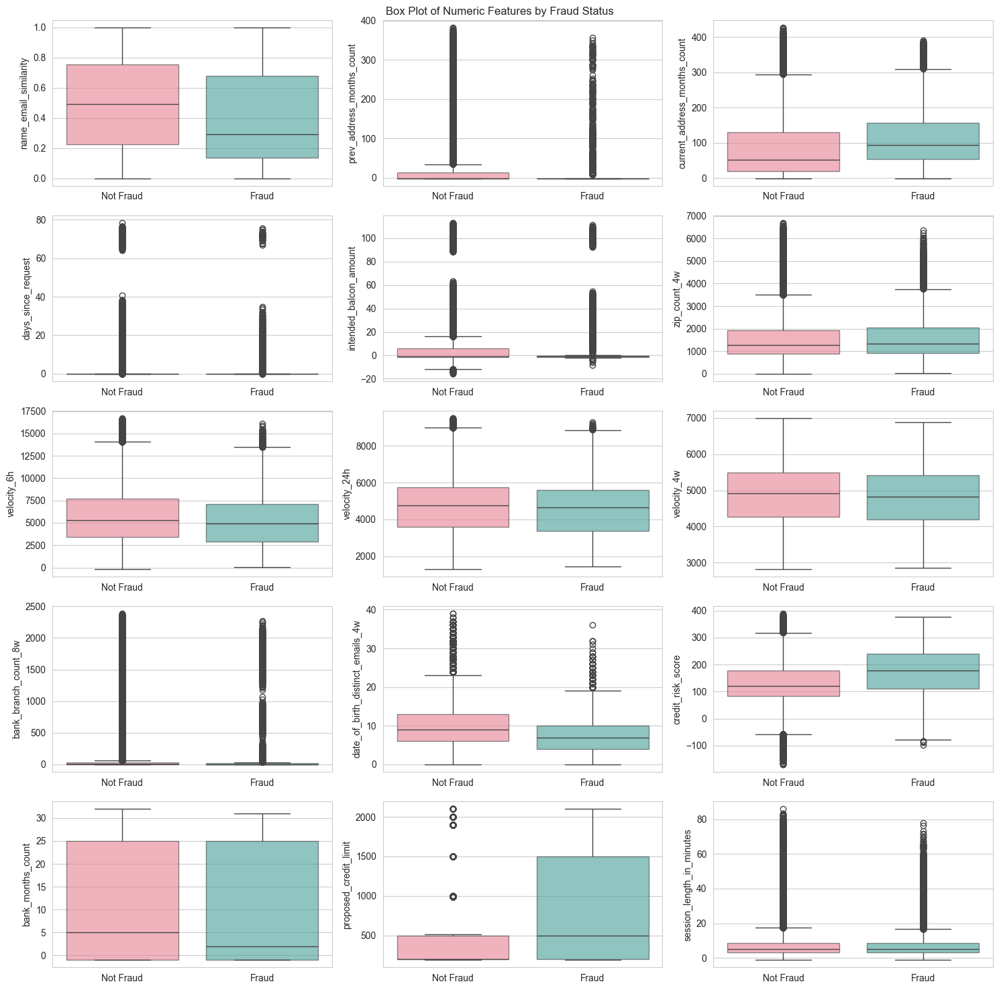

In [91]:
import seaborn as sns
import matplotlib.pyplot as plt
# Set Matplotlib to display plots inline in the notebook
%matplotlib inline

# Define custom color palette
my_palette = sns.color_palette("husl", 2)
sns.set_style("whitegrid")


# Create a grid of subplots
fig, axes = plt.subplots(nrows=5, ncols=3, figsize=(15, 15))

# Add a title to the figure
fig.suptitle('Box Plot of Numeric Features by Fraud Status')

numeric_features = [x for x in df.columns if df[x].nunique() >= 10]


# Loop through the numeric features and plot a box plot for each feature
for i, feature in enumerate(numeric_features):
    ax = axes[i // 3][i % 3]
    sns.boxplot(data=df, x='fraud_bool', y=feature, ax=ax, palette=my_palette, boxprops=dict(alpha=.6))
    ax.set_xlabel('')
    ax.set_ylabel(feature)
    ax.set_xticklabels(['Not Fraud', 'Fraud'])

# Adjust the layout and display the plot
plt.tight_layout()
plt.show()

Removing outliers in the context of imbalanced data can pose challenges. Outliers may contain valuable information or represent rare instances of the minority class. Their removal can lead to information loss, distort the class distribution, introduce bias towards the majority class, and deviate from real-world scenarios.

Considering the potential impact on model performance, it is important to exercise caution and explore alternative approaches that preserve the integrity of the imbalanced data while addressing outliers, such as robust modeling techniques or outlier detection methods specifically designed for imbalanced datasets.

Data Prep + Feature Engineering for Fraud Detection of Bank Account Applications

One-Hot Encoding for Categorical Features

One-hot encoding categorical features is a valuable technique that transforms them into a format suitable for machine learning. It represents each category as a binary variable, capturing their distinctness and independence. By utilising one-hot encoding, the algorithm can effectively incorporate categorical information during model training. This enables better prediction and accurate decision-making based on the categorical feature values.

In [92]:
s = (df.dtypes == 'object') # list of column-names and wether they contain categorical features
object_cols = list(s[s].index) # All the columns containing these features
print(object_cols)

['payment_type', 'employment_status', 'housing_status', 'source', 'device_os']


In [93]:
# Get a summary of statistical information for each non-numerical column in the DataFrame
df.describe(include=["object", "bool"]).transpose()

,count,unique,top,freq
payment_type,1000000,5,AB,370554
employment_status,1000000,7,CA,730252
housing_status,1000000,7,BC,372143
source,1000000,2,INTERNET,992952
device_os,1000000,5,other,342728


In [94]:
# Convert categorical variables into dummy variables using one-hot encoding
new_df = pd.DataFrame(pd.get_dummies(df, prefix=object_cols,dtype=int))
new_df.head()

,fraud_bool,income,name_email_similarity,prev_address_months_count,current_address_months_count,customer_age,days_since_request,intended_balcon_amount,zip_count_4w,velocity_6h,...,housing_status_BE,housing_status_BF,housing_status_BG,source_INTERNET,source_TELEAPP,device_os_linux,device_os_macintosh,device_os_other,device_os_windows,device_os_x11
0,0,0.3,0.986506,-1,25,40,0.006735,102.453711,1059,13096.035018,...,0,0,0,1,0,1,0,0,0,0
1,0,0.8,0.617426,-1,89,20,0.010095,-0.849551,1658,9223.283431,...,0,0,0,1,0,0,0,1,0,0
2,0,0.8,0.996707,9,14,40,0.012316,-1.490386,1095,4471.472149,...,0,0,0,1,0,0,0,0,1,0
3,0,0.6,0.475100,11,14,30,0.006991,-1.863101,3483,14431.993621,...,0,0,0,1,0,1,0,0,0,0
4,0,0.9,0.842307,-1,29,40,5.742626,47.152498,2339,7601.511579,...,0,0,0,1,0,0,0,1,0,0


In [95]:
# Split data into features and target
X = new_df.drop(['fraud_bool'], axis=1) #exclude target in the training
y = new_df['fraud_bool']


Min-Max Scaling for Numerical Features

MinMax scaling is employed to normalise numerical features within a specific range, usually 0 to 1. This technique standardises the features, ensuring equitable evaluation during training. By applying MinMax scaling, the numerical features become comparable, resulting in more dependable and precise outcomes from the machine learning algorithm.

In [96]:
# Import the necessary libraries for data preprocessing
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import MinMaxScaler

# Scale the numeric features in the training and testing sets using MinMaxScaler
numeric_transformer = MinMaxScaler()

# Define the ColumnTransformer object with the numeric transformer and the list of numeric features
preprocessor = ColumnTransformer([('scaled', numeric_transformer, numeric_features)], remainder='passthrough')

# Fit the preprocessor on the training set and transform both the training and testing sets
X_scaled = preprocessor.fit_transform(X)
# X_test_scaled = preprocessor.transform(X_test)

# Get the names of the features after pre-processing
feature_names = preprocessor.get_feature_names_out()

# Remove 'remainder__' from the feature names
feature_names = [feature.replace('remainder__', '') for feature in feature_names]

# Print the pre-processed feature names
print(feature_names)

['scaled__name_email_similarity', 'scaled__prev_address_months_count', 'scaled__current_address_months_count', 'scaled__days_since_request', 'scaled__intended_balcon_amount', 'scaled__zip_count_4w', 'scaled__velocity_6h', 'scaled__velocity_24h', 'scaled__velocity_4w', 'scaled__bank_branch_count_8w', 'scaled__date_of_birth_distinct_emails_4w', 'scaled__credit_risk_score', 'scaled__bank_months_count', 'scaled__proposed_credit_limit', 'scaled__session_length_in_minutes', 'income', 'customer_age', 'email_is_free', 'phone_home_valid', 'phone_mobile_valid', 'has_other_cards', 'foreign_request', 'keep_alive_session', 'device_distinct_emails_8w', 'device_fraud_count', 'month', 'payment_type_AA', 'payment_type_AB', 'payment_type_AC', 'payment_type_AD', 'payment_type_AE', 'employment_status_CA', 'employment_status_CB', 'employment_status_CC', 'employment_status_CD', 'employment_status_CE', 'employment_status_CF', 'employment_status_CG', 'housing_status_BA', 'housing_status_BB', 'housing_status_B

In [97]:
# Convert the scaled training and testing sets to pandas DataFrames
X_scaled = pd.DataFrame(X_scaled, columns=feature_names)


In [98]:
X_scaled.head()

,scaled__name_email_similarity,scaled__prev_address_months_count,scaled__current_address_months_count,scaled__days_since_request,scaled__intended_balcon_amount,scaled__zip_count_4w,scaled__velocity_6h,scaled__velocity_24h,scaled__velocity_4w,scaled__bank_branch_count_8w,...,housing_status_BE,housing_status_BF,housing_status_BG,source_INTERNET,source_TELEAPP,device_os_linux,device_os_macintosh,device_os_other,device_os_windows,device_os_x11
0,0.986507,0.000000,0.060606,0.000086,0.918255,0.157934,0.785651,0.798218,0.939390,0.002096,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0
1,0.617426,0.000000,0.209790,0.000129,0.114260,0.247350,0.556307,0.541631,0.747399,0.001258,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
2,0.996708,0.026042,0.034965,0.000157,0.109273,0.163308,0.274904,0.508333,0.759605,0.006289,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
3,0.475100,0.031250,0.034965,0.000089,0.106372,0.519779,0.864767,0.664714,0.754276,0.004612,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0
4,0.842307,0.000000,0.069930,0.073195,0.487853,0.349007,0.460265,0.465935,0.747175,0.000419,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0


Feature Selection for Fraud Detection of Bank Account Applications

Resampling for Effective Feature Selection Tests: Undersampling instances of the majority class, the dataset becomes more balanced, allowing for a fairer evaluation of the feature selection process. This approach helps mitigate any potential bias towards the majority class and ensures that the selected features are robust and informative for both classes.

In [99]:
# Import the necessary libraries for undersampling imbalanced datasets
from imblearn.under_sampling import NearMiss
from collections import Counter


# Perform NearMiss undersampling to handle imbalanced data
print(f'Test dataset samples per class {Counter(y)}')

# Define the NearMiss undersampling object with a sampling strategy of 1 and all available CPU cores
nm = NearMiss(sampling_strategy=1, n_jobs=-1)

# Perform NearMiss undersampling on the feature matrix X and target variable y
X_scaled_nm, y_scaled_nm = nm.fit_resample(X_scaled, y)

# Print the number of occurrences of each class in the resampled dataset
print('Resampled dataset shape %s' % Counter(y_scaled_nm))

Test dataset samples per class Counter({0: 988971, 1: 11029})
Resampled dataset shape Counter({0: 11029, 1: 11029})


Drop constants

In [100]:
# # Instantiate a VarianceThreshold selector and fit it to the NearMiss-resampled training set
# selector = VarianceThreshold()
# selector.fit(X_scaled_nm)

# # Get the names of the constant features
# constant_features = [feature for feature in X_scaled_nm.columns 
#                      if feature not in X_scaled_nm.columns[selector.get_support()]]

# # Print the names of the constant features
# print(constant_features)

'''Features with no variance have been dropped from the dataset to improve the quality of the analysis. 
These features provide no useful information as they exhibit the same value across all instances. 
By removing them, we eliminate redundancy and reduce noise, enabling a more focused and accurate exploration of the remaining features.'''


# Dropping constant features
X_scaled_nm.drop(['device_fraud_count'], axis=1, inplace=True)

Test numeric columns for for Multicollinearity: Pearson correlation is used to measure linear relationship between features. Fortunately, no features displayed a correlation exceeding 0.67, indicating a lack of strong linear dependencies.

In [102]:
# Create a list of numerical features in the DataFrame X_scaled_nm OR manually do it since not all numeric columns have more then 10 distinct values
numeric_features = [feature for feature in X_scaled_nm.columns if X_scaled_nm[feature].nunique() >= 10]

print(numeric_features)

['scaled__name_email_similarity', 'scaled__prev_address_months_count', 'scaled__current_address_months_count', 'scaled__days_since_request', 'scaled__intended_balcon_amount', 'scaled__zip_count_4w', 'scaled__velocity_6h', 'scaled__velocity_24h', 'scaled__velocity_4w', 'scaled__bank_branch_count_8w', 'scaled__date_of_birth_distinct_emails_4w', 'scaled__credit_risk_score', 'scaled__bank_months_count', 'scaled__proposed_credit_limit', 'scaled__session_length_in_minutes']


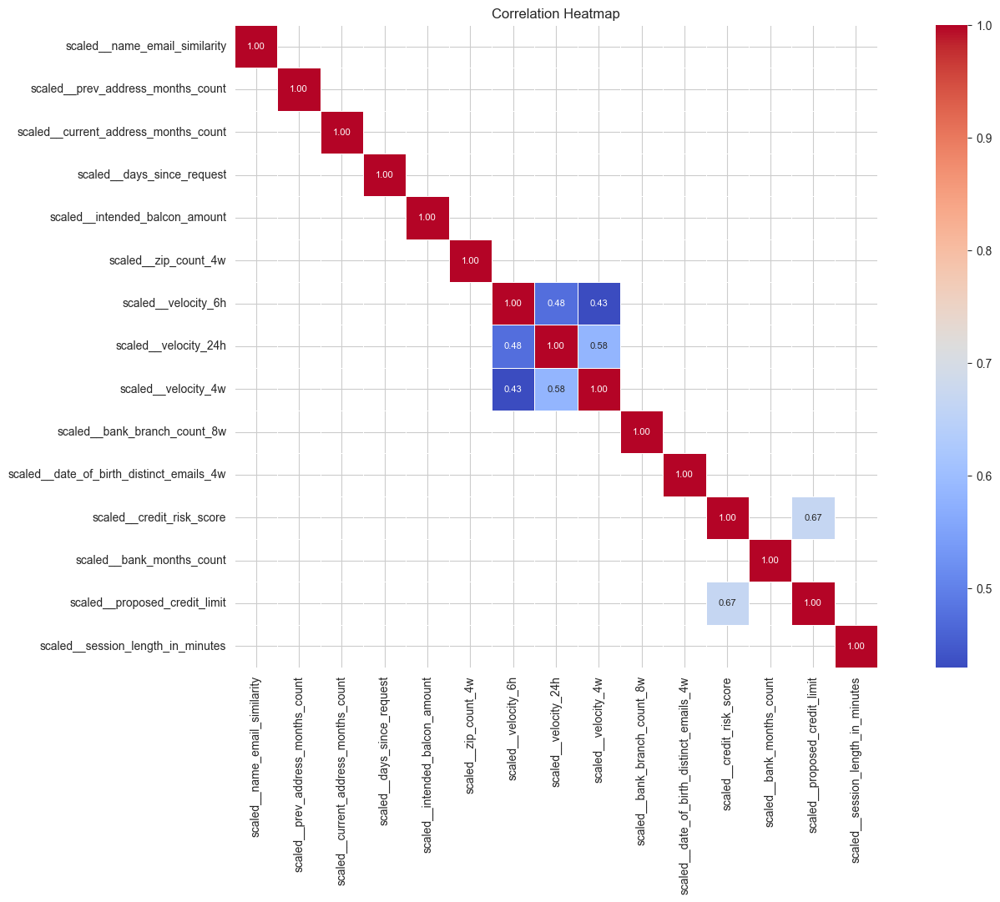

In [103]:
# Compute correlation matrix
X_train_corr = X_scaled_nm[numeric_features].corr()

# Plot correlation matrix with annotated values
fig, ax = plt.subplots(figsize=(18, 10))
sns.heatmap(X_train_corr[(X_train_corr >= 0.4) | (X_train_corr <= -0.4)], annot=True, fmt=".2f", cmap='coolwarm', linewidths=.5, square=True, ax=ax, annot_kws={"fontsize": 8})
plt.title('Correlation Heatmap')
plt.show()

Test for Categorical Features: To explore the connection between categorical features and the target variable, a chi-squared test was conducted. This statistical analysis allowed us to evaluate the relationship between the categorical variables and the target feature. The results of the chi-squared test unveiled an intriguing insight: among the examined categorical features, customer_age stood out as the most influential predictor of the target variable.

In [104]:
# Create a list of categorical features in the DataFrame X_scaled_nm OR select manually based on knowledge e.g income is not categorical
categorical_features = [feature for feature in X_scaled_nm.columns if X_scaled_nm[feature].nunique() >= 2 and X_scaled_nm[feature].nunique() < 10]

print(categorical_features)

['income', 'customer_age', 'email_is_free', 'phone_home_valid', 'phone_mobile_valid', 'has_other_cards', 'foreign_request', 'keep_alive_session', 'device_distinct_emails_8w', 'month', 'payment_type_AA', 'payment_type_AB', 'payment_type_AC', 'payment_type_AD', 'payment_type_AE', 'employment_status_CA', 'employment_status_CB', 'employment_status_CC', 'employment_status_CD', 'employment_status_CE', 'employment_status_CF', 'employment_status_CG', 'housing_status_BA', 'housing_status_BB', 'housing_status_BC', 'housing_status_BD', 'housing_status_BE', 'housing_status_BF', 'housing_status_BG', 'source_INTERNET', 'source_TELEAPP', 'device_os_linux', 'device_os_macintosh', 'device_os_other', 'device_os_windows', 'device_os_x11']


In [105]:
# Check the distribution of values in each column - drop missing value records
X_scaled_nm.device_distinct_emails_8w.value_counts()

device_distinct_emails_8w
 1.0    20865
 2.0     1038
 0.0      151
-1.0        4
Name: count, dtype: int64

In [106]:
rows_to_drop = np.where(X_scaled_nm['device_distinct_emails_8w'] < 0)[0]
rows_to_drop

# Drop the corresponding rows in X_train and y_train
X_train_cat = X_scaled_nm[categorical_features].copy()
X_train_cat.drop(rows_to_drop, axis=0, inplace=True)

y_train_cat = y_scaled_nm.copy()
y_train_cat.drop(rows_to_drop, axis=0, inplace=True)

In [107]:
# Use chi-squared test to evaluate the relationship between categorical features and the target variable
# Import the necessary libraries for feature selection
from sklearn.feature_selection import VarianceThreshold, SelectKBest, SelectFromModel, chi2, mutual_info_classif
chi2_results = chi2(X_train_cat, y_train_cat)

/var/folders/8w/mv0nvzh126z_rwpbhvx_k4mh0000gn/T/ipykernel_97700/2945060494.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=chi2_results_df.sort_values(by='chi2', ascending=False), x="feature", y="chi2", palette=my_palette, alpha=.6)
/var/folders/8w/mv0nvzh126z_rwpbhvx_k4mh0000gn/T/ipykernel_97700/2945060494.py:7: UserWarning: 
The palette list has fewer values (2) than needed (36) and will cycle, which may produce an uninterpretable plot.
  sns.barplot(data=chi2_results_df.sort_values(by='chi2', ascending=False), x="feature", y="chi2", palette=my_palette, alpha=.6)


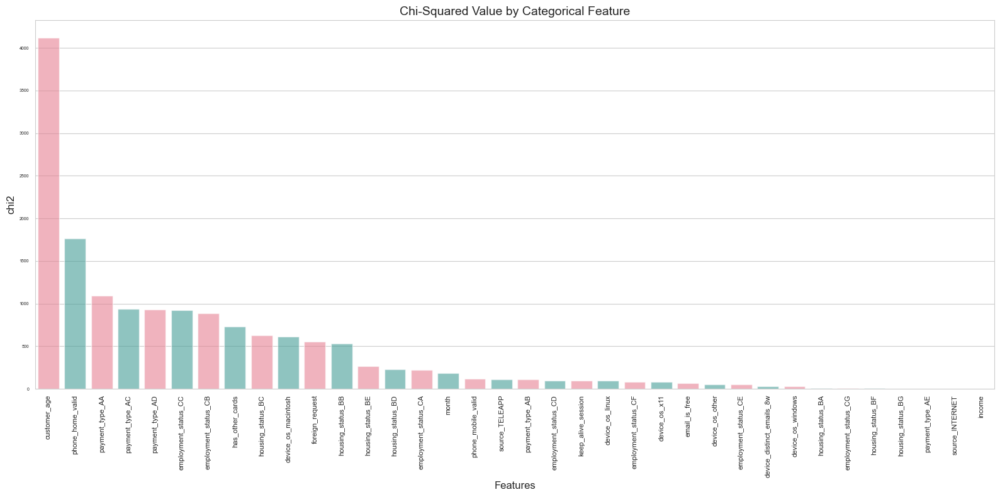

In [108]:
# Create a pandas DataFrame to store the chi-squared test results
chi2_results_df = pd.DataFrame(data={'feature': X_train_cat.columns, 'chi2': chi2_results[0], 'p_value': chi2_results[1]})
# Set up plot
plt.figure(figsize=(16, 8))

# Create bar plot
sns.barplot(data=chi2_results_df.sort_values(by='chi2', ascending=False), x="feature", y="chi2", palette=my_palette, alpha=.6)

# Customize labels and legend
plt.xlabel("Features", fontsize=12)
plt.ylabel("chi2", fontsize=12)
plt.xticks(rotation=90, fontsize=8)
plt.yticks(fontsize=5)
plt.title("Chi-Squared Value by Categorical Feature", fontsize=14)

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()

In [109]:
# Use SelectKBest with chi-squared test to select the top 5 categorical features that are most strongly associated with the target variable
best_chi2_cols = SelectKBest(chi2, k=15)
best_chi2_cols.fit(X_train_cat, y_train_cat)

# Get the names of the top 5 features
best_chi2_features = [X_train_cat.columns[best_chi2_cols.get_support()]]

# Print the names of the top 5 features
print(best_chi2_features)

[Index(['customer_age', 'phone_home_valid', 'has_other_cards',
       'foreign_request', 'payment_type_AA', 'payment_type_AC',
       'payment_type_AD', 'employment_status_CA', 'employment_status_CB',
       'employment_status_CC', 'housing_status_BB', 'housing_status_BC',
       'housing_status_BD', 'housing_status_BE', 'device_os_macintosh'],
      dtype='object')]


Mutual Information Test for Numeric Features: This statistical analysis allows us to evaluate the relationship between the numeric variables and the target feature. The results of the mutual information test unveiled an intriguing insight: among the examined numeric features, bank_months_count, current_address_months_count, and prev_address_months_count stood out as the most influential predictor of the target variable.

/var/folders/8w/mv0nvzh126z_rwpbhvx_k4mh0000gn/T/ipykernel_97700/3257788017.py:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=mutual_info_results_df.sort_values(by='mutual_info', ascending=False), x="feature", y="mutual_info", palette=my_palette, alpha=.6)
/var/folders/8w/mv0nvzh126z_rwpbhvx_k4mh0000gn/T/ipykernel_97700/3257788017.py:17: UserWarning: 
The palette list has fewer values (2) than needed (15) and will cycle, which may produce an uninterpretable plot.
  sns.barplot(data=mutual_info_results_df.sort_values(by='mutual_info', ascending=False), x="feature", y="mutual_info", palette=my_palette, alpha=.6)


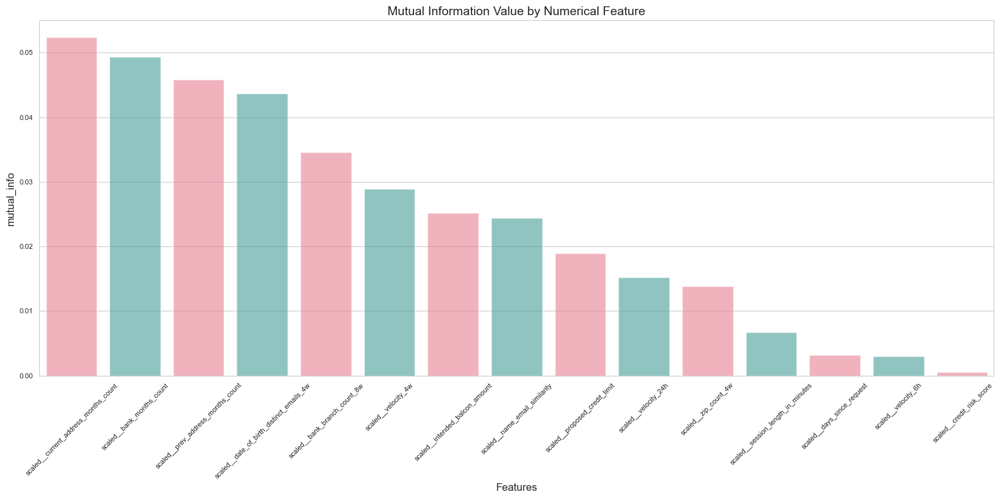

[Index(['scaled__prev_address_months_count',
       'scaled__current_address_months_count', 'scaled__bank_branch_count_8w',
       'scaled__date_of_birth_distinct_emails_4w',
       'scaled__bank_months_count'],
      dtype='object')]


In [112]:
# Create a new DataFrame with only the numeric features from the preprocessed training data
X_train_num = X_scaled_nm[numeric_features].copy()

# Create a copy of the target variable
y_train_num = y_scaled_nm.copy()

# Use mutual information test to evaluate the relationship between numerical features and the target variable
mutual_info_results = mutual_info_classif(X_train_num, y_train_num)

# Create a pandas DataFrame to store the mutual information test results
mutual_info_results_df = pd.DataFrame(data={'feature': X_train_num.columns, 'mutual_info': mutual_info_results})

# Set up plot
plt.figure(figsize=(16, 8))

# Create bar plot
sns.barplot(data=mutual_info_results_df.sort_values(by='mutual_info', ascending=False), x="feature", y="mutual_info", palette=my_palette, alpha=.6)

# Customize labels and legend
plt.xlabel("Features", fontsize=12)
plt.ylabel("mutual_info", fontsize=12)
plt.xticks(rotation=45, fontsize=8)
plt.yticks(fontsize=8)
plt.title("Mutual Information Value by Numerical Feature", fontsize=14)

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()

# Use SelectKBest with mutual information test to select the top 5 numerical features that are most strongly associated with the target variable
best_mutual_info_cols = SelectKBest(mutual_info_classif, k=5)
best_mutual_info_cols.fit(X_train_num, y_train_num)

# Get the names of the top 5 features
best_mutual_info_features = [X_train_num.columns[best_mutual_info_cols.get_support()]]

# Print the names of the top 5 features
print(best_mutual_info_features)

Decision Tree Classifier for Feature Slection: The decision to employ the ExtraTreesClassifier for feature selection was motivated by its robustness and compatibility with our dataset. In contrast to the chi-squared and mutual information tests, the ExtraTreesClassifier yielded different outcomes. After evaluating various features using this model, we identified the most influential predictors for the target feature. Notably, employment_status_CA, phone_home_valid, customer_age, payment_type_AC, and phone_mobile_valid emerged as the top features.

['scaled__name_email_similarity', 'scaled__current_address_months_count', 'scaled__days_since_request', 'scaled__intended_balcon_amount', 'scaled__zip_count_4w', 'scaled__velocity_6h', 'scaled__velocity_24h', 'scaled__velocity_4w', 'scaled__bank_branch_count_8w', 'scaled__date_of_birth_distinct_emails_4w', 'scaled__credit_risk_score', 'scaled__bank_months_count', 'scaled__proposed_credit_limit', 'scaled__session_length_in_minutes', 'income', 'customer_age', 'phone_home_valid', 'phone_mobile_valid', 'has_other_cards', 'device_distinct_emails_8w', 'month', 'payment_type_AA', 'payment_type_AC', 'payment_type_AD', 'employment_status_CA', 'housing_status_BC', 'device_os_windows']


/var/folders/8w/mv0nvzh126z_rwpbhvx_k4mh0000gn/T/ipykernel_97700/1743204359.py:21: UserWarning: The palette list has more values (2) than needed (1), which may not be intended.
  sns.barplot(data=extra_importances.sort_values(by='importance', ascending=False), x="feature", y="importance", hue="model", palette=my_palette, alpha=.6)


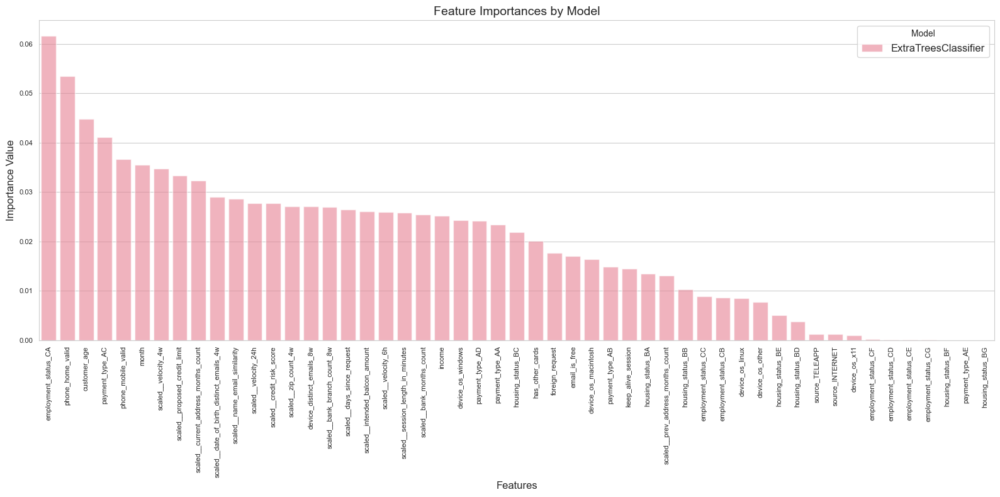

In [113]:
from sklearn.ensemble import ExtraTreesClassifier
extra = ExtraTreesClassifier(n_estimators=50, random_state=0)
extra.fit(X_scaled_nm, y_scaled_nm)

# Create a SelectFromModel object with the fitted Random Forest model
feature_sel_extra = SelectFromModel(extra, prefit=True)

# Get the names of the selected features by calling .get_support() on the SelectFromModel object
best_extra_features = [X_scaled_nm.columns[(feature_sel_extra.get_support())]]
best_extra_features = list(best_extra_features[0])

# Print the names of the selected features
print(best_extra_features)

extra_importances = pd.DataFrame({'feature': X_scaled_nm.columns, 'importance': extra.feature_importances_, 'model': 'ExtraTreesClassifier'})

# Set up plot
plt.figure(figsize=(16, 8))

# Create grouped bar plot
sns.barplot(data=extra_importances.sort_values(by='importance', ascending=False), x="feature", y="importance", hue="model", palette=my_palette, alpha=.6)

# Customize labels and legend
plt.xlabel("Features", fontsize=12)
plt.ylabel("Importance Value", fontsize=12)
plt.xticks(rotation=90, fontsize=8)
plt.yticks(fontsize=8)
plt.title("Feature Importances by Model", fontsize=14)
plt.legend(title='Model', fontsize=12)

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()

In [114]:
X_scaled.head()

,scaled__name_email_similarity,scaled__prev_address_months_count,scaled__current_address_months_count,scaled__days_since_request,scaled__intended_balcon_amount,scaled__zip_count_4w,scaled__velocity_6h,scaled__velocity_24h,scaled__velocity_4w,scaled__bank_branch_count_8w,...,housing_status_BE,housing_status_BF,housing_status_BG,source_INTERNET,source_TELEAPP,device_os_linux,device_os_macintosh,device_os_other,device_os_windows,device_os_x11
0,0.986507,0.000000,0.060606,0.000086,0.918255,0.157934,0.785651,0.798218,0.939390,0.002096,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0
1,0.617426,0.000000,0.209790,0.000129,0.114260,0.247350,0.556307,0.541631,0.747399,0.001258,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
2,0.996708,0.026042,0.034965,0.000157,0.109273,0.163308,0.274904,0.508333,0.759605,0.006289,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
3,0.475100,0.031250,0.034965,0.000089,0.106372,0.519779,0.864767,0.664714,0.754276,0.004612,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0
4,0.842307,0.000000,0.069930,0.073195,0.487853,0.349007,0.460265,0.465935,0.747175,0.000419,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0


In [115]:
X_scaled.shape

(1000000, 52)

In [116]:
X_scaled.columns

Index(['scaled__name_email_similarity', 'scaled__prev_address_months_count',
       'scaled__current_address_months_count', 'scaled__days_since_request',
       'scaled__intended_balcon_amount', 'scaled__zip_count_4w',
       'scaled__velocity_6h', 'scaled__velocity_24h', 'scaled__velocity_4w',
       'scaled__bank_branch_count_8w',
       'scaled__date_of_birth_distinct_emails_4w', 'scaled__credit_risk_score',
       'scaled__bank_months_count', 'scaled__proposed_credit_limit',
       'scaled__session_length_in_minutes', 'income', 'customer_age',
       'email_is_free', 'phone_home_valid', 'phone_mobile_valid',
       'has_other_cards', 'foreign_request', 'keep_alive_session',
       'device_distinct_emails_8w', 'device_fraud_count', 'month',
       'payment_type_AA', 'payment_type_AB', 'payment_type_AC',
       'payment_type_AD', 'payment_type_AE', 'employment_status_CA',
       'employment_status_CB', 'employment_status_CC', 'employment_status_CD',
       'employment_status_CE', 'em

In [117]:
y.value_counts()

fraud_bool
0    988971
1     11029
Name: count, dtype: int64

Keep only important features

In [118]:
X_scaled_nm.columns[(feature_sel_extra.get_support())]

Index(['scaled__name_email_similarity', 'scaled__current_address_months_count',
       'scaled__days_since_request', 'scaled__intended_balcon_amount',
       'scaled__zip_count_4w', 'scaled__velocity_6h', 'scaled__velocity_24h',
       'scaled__velocity_4w', 'scaled__bank_branch_count_8w',
       'scaled__date_of_birth_distinct_emails_4w', 'scaled__credit_risk_score',
       'scaled__bank_months_count', 'scaled__proposed_credit_limit',
       'scaled__session_length_in_minutes', 'income', 'customer_age',
       'phone_home_valid', 'phone_mobile_valid', 'has_other_cards',
       'device_distinct_emails_8w', 'month', 'payment_type_AA',
       'payment_type_AC', 'payment_type_AD', 'employment_status_CA',
       'housing_status_BC', 'device_os_windows'],
      dtype='object')

In [130]:
features_to_keep=['scaled__prev_address_months_count',
       'scaled__current_address_months_count', 'scaled__bank_branch_count_8w',
       'scaled__date_of_birth_distinct_emails_4w',
       'scaled__bank_months_count','customer_age','phone_home_valid','payment_type_AA','payment_type_AC','payment_type_AD','employment_status_CC',
       'employment_status_CB','employment_status_CA','phone_mobile_valid','scaled__velocity_4w','scaled__proposed_credit_limit','scaled__name_email_similarity',
       'scaled__days_since_request', 'scaled__intended_balcon_amount',
       'scaled__zip_count_4w', 'scaled__velocity_6h', 'scaled__velocity_24h',
        'scaled__credit_risk_score',
       'scaled__proposed_credit_limit',
       'scaled__session_length_in_minutes', 'income', 'month',
       'has_other_cards',
       'device_distinct_emails_8w',
       'housing_status_BC', 'device_os_windows'
       ]

In [131]:
X_scaled_final=X_scaled[features_to_keep]
X_scaled_final.columns

Index(['scaled__prev_address_months_count',
       'scaled__current_address_months_count', 'scaled__bank_branch_count_8w',
       'scaled__date_of_birth_distinct_emails_4w', 'scaled__bank_months_count',
       'customer_age', 'phone_home_valid', 'payment_type_AA',
       'payment_type_AC', 'payment_type_AD', 'employment_status_CC',
       'employment_status_CB', 'employment_status_CA', 'phone_mobile_valid',
       'scaled__velocity_4w', 'scaled__proposed_credit_limit',
       'scaled__name_email_similarity', 'scaled__days_since_request',
       'scaled__intended_balcon_amount', 'scaled__zip_count_4w',
       'scaled__velocity_6h', 'scaled__velocity_24h',
       'scaled__credit_risk_score', 'scaled__proposed_credit_limit',
       'scaled__session_length_in_minutes', 'income', 'month',
       'has_other_cards', 'device_distinct_emails_8w', 'housing_status_BC',
       'device_os_windows'],
      dtype='object')

Model Development

Training Functions using SMOTE and Grid Search CV: SMOTE generates synthetic data points to create an equal balance between the minority and majority class. SMOTE retains more information since no rows are eliminated, unlike random under-sampling. However, SMOTE can take longer to train due to the generation of synthetic data.

When using SMOTE or undersampling techniques, it is crucial not to apply them before cross-validation. This is because it can influence the validation set before the cross-validation process, leading to overfitting. By doing so, we risk introducing data leakage. Instead, we should generate synthetic data points during cross-validation to avoid affecting the validation set. In this way, synthetic data is created only for the training set, ensuring that the validation set remains untouched.

Function to train selected classifier

In [183]:
# # Import the necessary libraries for oversampling imbalanced datasets
# from imblearn.over_sampling import SMOTENC
# from imblearn.pipeline import make_pipeline
# # Import necessary modules for hyperparameter tuning
# from sklearn.model_selection import StratifiedKFold, RandomizedSearchCV, GridSearchCV

# def train_classifier(lr, param_dist, X_train, y_train, encoded_features, search_type='random'):
    """
    Train a classifier using the specified parameters and return the trained model.
    
    Parameters:
    classifier (sklearn estimator): The estimator to train.
    param_dist (dict): The distribution of parameters to search over.
    X_train (pandas DataFrame): The training features.
    y_train (pandas Series): The training target.
    encoded_features (list): A list of encoded categorical features.
    search_type (str, optional): The type of hyperparameter search to perform. Must be either 'random' or 'grid'. Defaults to 'random'.
    
    Returns:
    A trained classifier.
    """
    
    # Apply SMOTENC to deal with imbalanced classes
    smote_nc = SMOTENC(categorical_features=encoded_features, sampling_strategy='minority', random_state=42)
        
    # Create pipeline with SMOTENC and the classifier
    pipeline = make_pipeline(smote_nc, lr)
    
    # Define cross-validation strategy
    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    
    # Perform hyperparameter search
    if search_type == 'random':
        search_cv = RandomizedSearchCV(estimator=pipeline, 
                                      param_distributions=param_dist,
                                      n_iter=20,
                                      scoring="roc_auc",
                                      n_jobs=-1,
                                      cv=cv)
    elif search_type == 'grid':
        search_cv = GridSearchCV(estimator=pipeline,
                                 param_grid=param_dist,
                                 scoring="roc_auc",
                                 n_jobs=-1,
                                 cv=cv)
    else:
        raise ValueError('search_type must be either "random" or "grid"')
        
    # Fit the model and return the trained classifier
    search_cv.fit(X_train, y_train)

    return search_cv

Tarin - Test Split Data

In [132]:
# Train test split by 'month', month 0-5 are train, 6-7 are test data as proposed in the paper
X_train = X_scaled_final[X_scaled_final['month']<6]
X_test = X_scaled_final[X_scaled_final['month']>=6]
y_train = y[X_scaled_final['month']<6]
y_test = y[X_scaled_final['month']>=6]

X_train.drop('month', axis=1, inplace=True)
X_test.drop('month', axis=1, inplace=True)

# alternativly: regular train_test_split
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

/var/folders/8w/mv0nvzh126z_rwpbhvx_k4mh0000gn/T/ipykernel_97700/3721125044.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_train.drop('month', axis=1, inplace=True)
/var/folders/8w/mv0nvzh126z_rwpbhvx_k4mh0000gn/T/ipykernel_97700/3721125044.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_test.drop('month', axis=1, inplace=True)


In [185]:
y_train.value_counts()

fraud_bool
0    786838
1      8151
Name: count, dtype: int64

In [219]:


from imblearn.over_sampling import SMOTE

sm = SMOTE(random_state = 2)
X_train_res, y_train_res = sm.fit_resample(X_train, y_train.ravel())

clf = LogisticRegression(solver='lbfgs',max_iter=1000)
clf.fit(X_train_res, y_train_res)

/var/folders/8w/mv0nvzh126z_rwpbhvx_k4mh0000gn/T/ipykernel_97700/1640483748.py:4: FutureWarning: Series.ravel is deprecated. The underlying array is already 1D, so ravel is not necessary.  Use `to_numpy()` for conversion to a numpy array instead.
  X_train_res, y_train_res = sm.fit_resample(X_train, y_train.ravel())


LogisticRegression(max_iter=1000)

In [222]:
y_pred = clf.predict(X_test)

In [223]:
print(confusion_matrix(y_test,y_pred))

[[157411  44722]
 [   712   2166]]


In [224]:
print(accuracy_score(y_test, y_pred))

0.7783826233714288


In [227]:
y_test

794989    0
794990    0
794991    0
794992    0
794993    0
         ..
999995    0
999996    0
999997    0
999998    0
999999    0
Name: fraud_bool, Length: 205011, dtype: int64

In [ ]:
# y_pred = classifier.predict(X_test)
# y_prob = classifier.predict_proba(X_test)[:, 1]

In [230]:
probabilities = clf.predict_proba(X_test)
df_probabilities = pd.DataFrame(probabilities, columns = ['prob_0', 'prob_1'])
df_predictions = pd.DataFrame(clf.predict(X_test), columns = ['predicted_TARGET'])
df_actuals = pd.DataFrame(list(y_test),columns= ['Actual Outcome'])

dfx=pd.concat([df_probabilities, df_predictions,df_actuals], axis=1)


In [232]:

dfx.to_csv("Fraud_Application_Model_Predictions.csv", sep=',', encoding='UTF-8')


In [231]:

dfx.tail()

,prob_0,prob_1,predicted_TARGET,Actual Outcome
205006,0.379551,0.620449,1,0
205007,0.832834,0.167166,0,0
205008,0.432465,0.567535,1,0
205009,0.541329,0.458671,0,0
205010,0.949958,0.050042,0,0


In [233]:
sorted_df=dfx.sort_values(by='prob_1')
sorted_df.head()
#create decile bins
sorted_df['Decile'] = pd.qcut(sorted_df['prob_1'], q=10, labels=False, duplicates='drop') + 1
sorted_df.tail(10)
#summary table - in each decile calculate how many were ACTUALLY GOOD/BAD vs predicted GOOD/BAD
summary_df=sorted_df.groupby('Decile').agg({ 
    'prob_0':['min','count'],
    'Actual Outcome':['sum',lambda x: (x == 1).sum()],
    'Actual Outcome':['sum',lambda y: (y == 0).sum()]
    }).reset_index()
summary_df.columns = ['Decile', 'min_threshold', 'num_Records','bad','good']
summary_df



,Decile,min_threshold,num_Records,bad,good
0,1,0.959882,20502,26,20476
1,2,0.921047,20501,27,20474
2,3,0.875970,20501,45,20456
3,4,0.821910,20501,61,20440
4,5,0.757529,20501,92,20409
5,6,0.679032,20501,111,20390
6,7,0.583249,20501,176,20325
7,8,0.462014,20501,257,20244
8,9,0.300005,20501,458,20043
9,10,0.004927,20501,1625,18876


In [234]:


summary_df['Cumulative_Good'] = summary_df['good'].cumsum()
summary_df['Cumulative_Bad'] = summary_df['bad'].cumsum()
summary_df

,Decile,min_threshold,num_Records,bad,good,Cumulative_Good,Cumulative_Bad
0,1,0.959882,20502,26,20476,20476,26
1,2,0.921047,20501,27,20474,40950,53
2,3,0.875970,20501,45,20456,61406,98
3,4,0.821910,20501,61,20440,81846,159
4,5,0.757529,20501,92,20409,102255,251
5,6,0.679032,20501,111,20390,122645,362
6,7,0.583249,20501,176,20325,142970,538
7,8,0.462014,20501,257,20244,163214,795
8,9,0.300005,20501,458,20043,183257,1253
9,10,0.004927,20501,1625,18876,202133,2878


In [235]:
#find the min of each decile, cumulative good + cumulative bad ==> sepcificity vs sensitivity

total_good_sum = summary_df['good'].sum()
total_bad_sum = summary_df['bad'].sum()

# Calculate the cumulative percentage
summary_df['Cumulative_Good_Percentage'] = (summary_df['Cumulative_Good'] / total_good_sum) * 100 #sensitivity
summary_df['Cumulative_Bad_Percentage'] = (summary_df['Cumulative_Bad'] / total_bad_sum) * 100
summary_df['Cumulative_Bad_Avoided_Percentage'] = (100-summary_df['Cumulative_Bad_Percentage'])  #1-specificity
summary_df

,Decile,min_threshold,num_Records,bad,good,Cumulative_Good,Cumulative_Bad,Cumulative_Good_Percentage,Cumulative_Bad_Percentage,Cumulative_Bad_Avoided_Percentage
0,1,0.959882,20502,26,20476,20476,26,10.129964,0.903405,99.096595
1,2,0.921047,20501,27,20474,40950,53,20.258938,1.841557,98.158443
2,3,0.875970,20501,45,20456,61406,98,30.379008,3.405142,96.594858
3,4,0.821910,20501,61,20440,81846,159,40.491162,5.524670,94.475330
4,5,0.757529,20501,92,20409,102255,251,50.587979,8.721334,91.278666
5,6,0.679032,20501,111,20390,122645,362,60.675397,12.578179,87.421821
6,7,0.583249,20501,176,20325,142970,538,70.730658,18.693537,81.306463
7,8,0.462014,20501,257,20244,163214,795,80.745846,27.623350,72.376650
8,9,0.300005,20501,458,20043,183257,1253,90.661594,43.537179,56.462821
9,10,0.004927,20501,1625,18876,202133,2878,100.000000,100.000000,0.000000


In [238]:
summary_df.to_csv("Data Interpretation.csv", sep=',', encoding='UTF-8')

In [236]:
def plot_roc_curves(fpr_list, tpr_list, label_list):
    plt.figure(figsize=(8, 8))
    for i in range(len(fpr_list)):
        # Compute the ROC AUC score
        roc_auc_score = auc(fpr_list[i], tpr_list[i])
        # Plot the ROC curve
        plt.plot(fpr_list[i], tpr_list[i], label=f'{label_list[i]} (AUC={roc_auc_score:.2f})')
    
    # Plot the random classifier curve
    plt.plot([0, 1], [0, 1], 'k--', label='Random')
    
    # Set the plot labels and title
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend()
    plt.show()


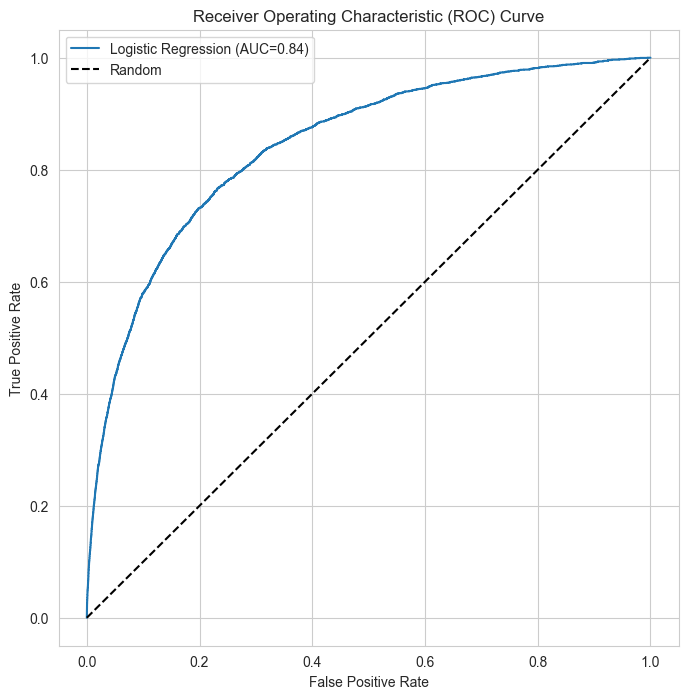

In [237]:

from sklearn.metrics import roc_curve
lr_fpr, lr_tpr, thresholds = roc_curve(y_test, clf.predict_proba(X_test)[:, 1])

# Create lists of FPR and TPR values for each classifier
fpr_list = [lr_fpr]
tpr_list = [lr_tpr]

# Create a list of labels for each classifier
label_list = ['Logistic Regression']

# Plot ROC curves for each classifier using the FPR, TPR, and label lists
plot_roc_curves(fpr_list, tpr_list, label_list)

Gridsearch and optimization

In [194]:
# Create first pipeline for base without reducing features.
from sklearn.model_selection import StratifiedKFold, RandomizedSearchCV, GridSearchCV
from sklearn.pipeline import Pipeline
#from sklearn.linear_model import LogisticRegression

pipe = Pipeline([('classifier' , LogisticRegression())])
# pipe = Pipeline([('classifier', RandomForestClassifier())])

# Create param grid.

param_grid = [
    {'classifier' : [LogisticRegression()],
     'classifier__penalty' : ['l1', 'l2'],
    'classifier__C' : np.logspace(-4, 4, 20),
    'classifier__solver' : ['liblinear']
    },
    # {'classifier' : [RandomForestClassifier()],
    # 'classifier__n_estimators' : list(range(10,101,10)),
    # 'classifier__max_features' : list(range(6,32,5))
    # }
]

# Create grid search object

clf = GridSearchCV(pipe, param_grid = param_grid, cv = 5, verbose=True, n_jobs=-1)

# Fit on data

best_clf = clf.fit(X_train, y_train)

Fitting 5 folds for each of 40 candidates, totalling 200 fits


In [195]:
y_pred2 = best_clf.predict(X_test)

In [199]:
print(confusion_matrix(y_test,y_pred2))

[[202132      1]
 [  2870      8]]


In [198]:
print(accuracy_score(y_test, y_pred2))

0.9859958733921594


In [153]:
# from sklearn.metrics import classification_report, precision_recall_fscore_support, confusion_matrix, auc, roc_curve

In [154]:
# def print_cls_report(y_test, y_pred, title):
#     # Calculate the classification report
#     default_report = classification_report(y_test, y_pred, target_names=['No Fraud', 'Fraud'])
    
#     # Calculate precision, recall, f1 score and support for each class
#     precision, recall, f1_score, support = precision_recall_fscore_support(y_test, y_pred)

#     # Print the title and the default classification report
#     print(title)
#     print('*****' * 10)
#     print(default_report)

#     # Return the recall scores for each class
#     return recall

In [155]:
# def plot_con_matrix(ax, y_test, y_pred, title):
#     # Define the classes of the classification problem
#     classes = ['No Fraud', 'Fraud']

#     # Compute the confusion matrix
#     con_matrix = confusion_matrix(y_test, y_pred)

#     # Compute the values for true negatives, false positives, false negatives, and true positives
#     tn, fp, fn, tp = con_matrix.ravel()

#     # Compute the false positive rate
#     fpr = fp / (fp + tn)

#     # Plot the confusion matrix using a heatmap
#     ax.imshow(con_matrix, interpolation='nearest', cmap=plt.cm.Blues)

#     # Define the tick marks and the labels for the plot
#     tick_marks = np.arange(len(classes))
#     ax.set_xticks(tick_marks)
#     ax.set_xticklabels(classes)
#     ax.set_yticks(tick_marks)
#     ax.set_yticklabels(classes)

#     # Add the count of each cell of the confusion matrix to the plot
#     fmt = 'd'
#     threshold = con_matrix.max() / 2.
#     for i, j in np.ndindex(con_matrix.shape):
#         ax.text(j, i, format(con_matrix[i, j], fmt),
#                  horizontalalignment="center",
#                  color="white" if con_matrix[i, j] > threshold else "black")

#     # Add labels to the plot
#     ax.set_xlabel('Predicted label')
#     ax.set_ylabel('True label')
#     ax.set_title(f'{title} with {fpr*100:.2f}% FPR')

In [156]:
# def print_cv_results(model):
#     # Get the parameter and score arrays from the cv_results_ dictionary
#     means = model.cv_results_['mean_test_score']
#     params = model.cv_results_['params']

#     # Combine the arrays using zip()
#     combined_results = zip(means, params)

#     # Sort the combined array by mean_test_score in descending order
#     sorted_results = sorted(combined_results, key=lambda x: x[0], reverse=True)

#     # Print the mean test score and the hyperparameters as a formatted string
#     for mean, param in sorted_results:
#         print("mean_test_score: %f, params: %r" % (mean, param))

In [157]:

# def plot_roc_curves(fpr_list, tpr_list, label_list):
#     plt.figure(figsize=(8, 8))
#     for i in range(len(fpr_list)):
#         # Compute the ROC AUC score
#         roc_auc_score = auc(fpr_list[i], tpr_list[i])
#         # Plot the ROC curve
#         plt.plot(fpr_list[i], tpr_list[i], label=f'{label_list[i]} (AUC={roc_auc_score:.2f})')
    
#     # Plot the random classifier curve
#     plt.plot([0, 1], [0, 1], 'k--', label='Random')
    
#     # Set the plot labels and title
#     plt.xlabel('False Positive Rate')
#     plt.ylabel('True Positive Rate')
#     plt.title('Receiver Operating Characteristic (ROC) Curve')
#     plt.legend()
#     plt.show()

In [158]:
# def test_classifier(classifier, X_test, y_test):
#     """
#     Evaluates a binary classifier by generating ROC curves, classification reports, and confusion matrices.
    
#     Parameters:
#     -----------
#     classifier : classifier object
#         Binary classifier object to be evaluated.
#     X_test : numpy.ndarray or pandas.DataFrame
#         Test feature data.
#     y_test : numpy.ndarray or pandas.Series
#         Test target labels.
        
#     Returns:
#     --------
#     tuple : A tuple containing four values - false positive rate (fpr), true positive rate (tpr),
#             default recall, and target recall.
#     """
    
#     # Predict class probabilities and labels using the trained classifier
#     y_pred = classifier.predict(X_test)
#     y_prob = classifier.predict_proba(X_test)[:, 1]

#     # Calculate the false positive rate and true positive rate for different threshold values
#     fpr, tpr, thresholds = roc_curve(y_test, y_prob)

#     # Choose a false positive rate threshold based on the ROC curve
#     target_fpr = 0.05
#     threshold_idx = np.argmin(np.abs(fpr - target_fpr))
#     threshold = thresholds[threshold_idx]
    
#     # Make predictions on the testing set using the threshold
#     y_pred_threshold = (y_prob >= threshold).astype(int)
    
#     # Print the classification report for both default and target threshold
#     default_recall = print_cls_report(y_test, y_pred, title="Default Threshold")
#     target_recall = print_cls_report(y_test, y_pred_threshold, title=f'Target Threshold @ {threshold:.2f}')

#     # Plot confusion matrix
#     fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))
    
#     default_matrix = plot_con_matrix(ax1, y_test, y_pred, title='Default Threshold @ 0.50')
#     target_matrix = plot_con_matrix(ax2, y_test, y_pred_threshold, title=f'Target Threshold @ {threshold:.2f}')

#     # Adjust subplots for better visibility
#     plt.tight_layout()
    
#     # Display the plots
#     plt.show()

#     return fpr, tpr, default_recall, target_recall

In [176]:
# encoded_features=[13, 7,8, 9, 10, 11, 12, 13,26, 27, 28,29]

In [184]:



# # Define a dictionary of hyperparameters for DecisionTreeClassifier
# lr_params = {'classifier__penalty' : ['l1', 'l2'],
#              'classifier__solver' : ['liblinear'],
#              #'classifier__C' : np.logspace(-4, 4, 20)
#             }
# # # Train a DecisionTree classifier using 'train_classifier' function and the given parameters
# lr_model = train_classifier(lr, lr_params, X_train, y_train, encoded_features)
# # Testing the DecisionTree model using the test data and calculating metrics
# #lr_fpr, lr_tpr, lr_default_recall, lr_target_recall = test_classifier(lr_model, X_test, y_test)

/Users/krithis/Documents/creditscoremodel/.venv/lib/python3.12/site-packages/sklearn/model_selection/_search.py:318: UserWarning: The total space of parameters 2 is smaller than n_iter=20. Running 2 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


ValueError: Invalid parameter 'classifier' for estimator Pipeline(steps=[('smotenc',
                 SMOTENC(categorical_features=[13, 7, 8, 9, 10, 11, 12, 13, 26,
                                               27, 28, 29],
                         random_state=42, sampling_strategy='minority')),
                ('logisticregression', LogisticRegression())]). Valid parameters are: ['memory', 'steps', 'verbose'].